<div style="text-align: center">
    <img src="../figures/JuliaEO2024_banner.png" alt="Descriptive Image Text" style="border:1px solid black"/>
</div>



The objectives of this workshop are the following:


- **Understand SAR Imagery**: Gain an understanding of SAR imagery, its properties, and why it's advantageous for maritime surveillance.
- **Data Handling**: Learn how to acquire and prepare SAR data from the Sentinel-1 satellite.
- **Apply Machine Learning**: Explore machine learning techniques, from basic classification to object detection models.
- **Real-World Application**: Gain practical skills in applying these models to real-world SAR data for effective maritime surveillance.



____________________



## Notebooks

- 1: [Sentinel-1 data acquisition](1_Data_acqusition.ipynb)
- 2: [Ship binary classification](2_Ship_binary_classification.ipynb)
- 3: [Two stage ship detection](3_two_stage_ship_detector.ipynb)
- 4: [One stage ship detection](4_One_stage_ship_detector.ipynb)

<div style="text-align: center">
    <img src="../figures/overview_notebooks.png" alt="Descriptive Image Text" width="800"/>
</div>



# Sentinel-1 Data acqustiion
 <a class="anchor" id="toc"></a>
-  [Objectives](#objective)
-  [Copernicus Dataspace](#copernicus_dataspace)
-  [Include modules](#init)
-  [Metadata](#metadata)
-  [Download](#download)


The Sentinel-1 mission, integral to the European Space Agency's Copernicus Programme, currently comprises of one satellite (Sentinel-1A) equipped with Synthetic Aperture Radar (SAR). This technology enables reliable, all-weather, day-and-night imaging of the Earth's surface, making it particularly effective for maritime surveillance.

* **All-Weather Capability**: SAR can penetrate clouds and darkness, offering consistent monitoring of maritime environments regardless of weather or time of day.

* **Ship Detection**: Sentinel-1 is adept at detecting and monitoring maritime vessels, including those in remote or high-seas areas, aiding in activities like maritime traffic monitoring and enforcement of regulations.

* **Environmental Monitoring**: The satellite plays a crucial role in detecting and tracking marine phenomena such as oil spills, aiding in environmental protection efforts.

Sentinel-1's frequent revisit times and wide-area coverage make it a valuable asset in the continuous observation and management of maritime activities.




## Objective
 <a class="anchor" id="objective"></a>


The objectives of this notebook are to provide a brief introduction to Sentinel-1 data and to demonstrate how to access and download Sentinel-1 data from the Copernicus Data Space. 



## Copernicus Dataspace
 <a class="anchor" id="copernicus_dataspace"></a>

Back to [Table of Content](#toc)



https://dataspace.copernicus.eu/ 



The Copernicus Data Space forms a cornerstone of the European Union's Copernicus Programme, a groundbreaking initiative in Earth observation and monitoring. As a robust and comprehensive data repository, it is pivotal in advancing our understanding and management of Earth's physical, biological, and human systems, with a particular emphasis on maritime domains. It will replace some of the maaany current options of getting Copernicus data, e.g., https://scihub.copernicus.eu/


In order to download data from the Copernicus Dataspace, you need an account. 


Currently, you can access data using
- OData
- STACK (currently not fully functionig)
- OpenSearch
- SentinelHub Catalog API (synergise and thus Planet)

Copernicus Dataspace furhtermore offers the following (some of them are still in development)
- On-demand processing (even from level-0)
- OGC API (to, e.g., ArcGIS or QGIS)
- Hosted Notebooks
- Traceability
- A cool dashboard


#### Copernicus Dataspace briefly

- **Wide-Ranging Satellite Data**: Hosting an expansive collection of satellite data, primarily from the Sentinel series, Copernicus Data Space is a treasure trove of information. This includes high-resolution imagery, atmospheric data, and more, covering the global expanse in meticulous detail.

- **Diverse Data for Varied Applications**: The versatility of the data makes it suitable for a range of applications, from climate change research to urban planning. In the context of maritime surveillance, it offers indispensable insights into oceanography, coastal dynamics, and marine ecosystems.



- **Maritime Safety and Security**: A primary application of Copernicus Data Space in maritime surveillance involves ensuring maritime safety and security. This includes monitoring sea routes for illegal activities, aiding in search and rescue operations, and ensuring compliance with maritime laws.

- **Environmental Monitoring and Protection**: The data plays a crucial role in tracking environmental phenomena like oil spills, algal blooms, and changes in sea ice. These insights are crucial for environmental protection efforts, conservation of marine biodiversity, and sustainable management of marine resources.

- **Fisheries Management**: Through the monitoring of marine habitats and fish migration patterns, the platform aids in sustainable fisheries management. This helps in combating overfishing and ensuring the health of marine food chains.



- **Ease of Access**: The platform ensures that the vast amounts of data are not only accessible but also user-friendly. With tools and interfaces designed for various user levels, it caters to both expert researchers and public stakeholders.

- **Real-Time Data for Timely Decisions**: Emphasizing the provision of near real-time data, Copernicus Data Space enables swift decision-making, crucial in dynamic maritime environments where conditions can change rapidly.

The figure below shows the website

<div style="text-align: center">
    <img src="../figures/notebooks/dataspace.png" alt="Descriptive Image Text" width="900" style="border:1px solid black"/>
</div>




Through the CopernicusDataspace, it is possible to download data from:
- Sentinel-1, -2, -3, -5p

And in the near future from:
- Landsat-5, -7, -8
- SMOS
- ENVISAT

As well as complementary data

<div class="alert alert-block alert-info"> <b>Task: </b>


1. Register for an account on Copernicus Dataspace. 
2. Save your username and password 

## Init
 <a class="anchor" id="init"></a>
Back to [Table of Content](#toc)

In [ ]:
using Pkg
using DotEnv

include("../src/Vessel_detection.jl")

using .Vessel_detection

DotEnv.config("../.env");

## Metadata
 <a class="anchor" id="metadata"></a>
Back to [Table of Content](#toc)

We will start by getting the metadata for our search

<div style="text-align: center">
    <img src="../figures/notebooks/download_order.png" alt="Descriptive Image Text" width="800"/>
</div>



Defining an area

In [2]:
bbox = Test_name.Download.Metadata.get_bbox([-27.227298,38.650065]);
start_datetime="2023-10-01T00:00:00Z"
end_datetime="2023-12-26T23:59:59Z"

Downloading the metadata

In [3]:
data = Test_name.Download.Metadata.download_metadata_copernicus(bbox=bbox,
start_datetime,start_datetime 
end_datetime,end_datetime,
max_records="5",
collection="Sentinel1",
product_type= "GRD",
verbose=1);


Request successful.


In order to illustrate it better, we transform to a dataframe

In [4]:
df = Test_name.Download.Metadata.vector_of_dicts_to_dataframe(data["features"]);
println(df)

5×51 DataFrame
 Row │ properties_polarisation  properties_orbitDirection  properties_title                   type     properties_thumbnail               geometry_coordinates_1             properties_license_viewService  properties_license_licenseId  properties_cloudCover  id                                 properties_status  properties_swath  properties_links_1_rel  properties_centroid_type  properties_license_hasToBeSigned  properties_processingLevel  properties_gmlgeometry             properties_updated        properties_productType  properties_platform  properties_centroid_coordinates_2  properties_startDate      properties_license_signatureQuota  properties_license_description_shortName  properties_license_grantedOrganizationCountries  properties_parentIdentifier  properties_instrument  properties_processingBaseline  properties_description             properties_license_grantedFlags  properties_productIdentifier       properties_sensorMode  properties_published      properties_snow

Looking at a quicklook

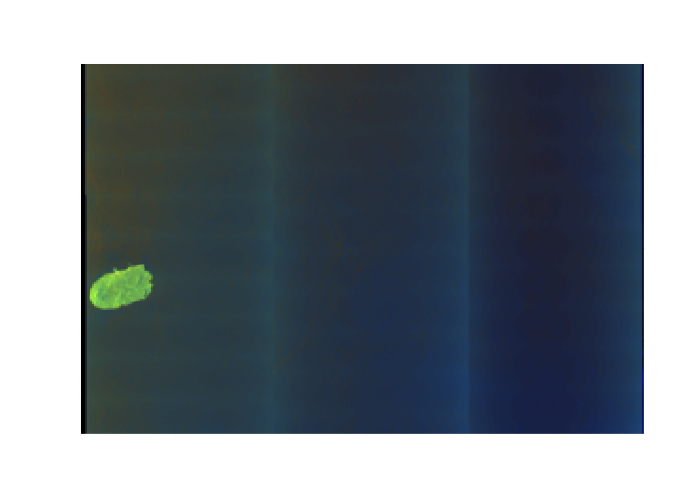

In [7]:
Test_name.Visualize.plot_quicklook_from_url(data,1)

The access token is only needed when downloading the data. Querying data can be done without an account.

<div class="alert alert-block alert-info"> <b>Task: </b>

1. Using the search parameters provided in the notebook, query some Sentinel-1 images.


## Download
 <a class="anchor" id="download"></a>
Back to [Table of Content](#toc)


In order to get data from Copernicus Datasspace, we need to have an access token, see https://documentation.dataspace.copernicus.eu/APIs/Token.html. 
After signing up, we can use our Username and Password to generate it automatically as illustrated below

In [8]:
access_token = Test_name.Download.get_access_token_copernicus(username = get(ENV, "DATASPACE_USERNAME", ""), password = get(ENV, "DATASPACE_PASSWORD", ""));

After we have seen and fitlered the metadata, we can download the images. Here, we only download the image shown above.

In [9]:
Test_name.Download.Products.download_product_copernicus(access_token = access_token, product_id = df[3,:id], filename="../data/test.zip")

File downloaded successfully.


In [10]:
Test_name.Download.Products.unzip_file(zip_path = "../data/test.zip", output_folder = "../data");

<div class="alert alert-block alert-info"> <b>Task: </b>


1. Using the username and password from Copernicus Dataspace, download a Sentinel-1 image. 

The image we will be using in the later workshops is S1A_IW_GRDH_1SDV_20231212T194138_20231212T194203_051626_063BD4_9836.SAFE.